In [4]:
import seaborn as sns
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [5]:
df=pd.read_csv("Classified_Data\Classified Data.csv",index_col=0)
df.head()

,WTT,PTI,EQW,SBI,LQE,QWG,FDJ,PJF,HQE,NXJ,TARGET CLASS
0,0.913917,1.162073,0.567946,0.755464,0.780862,0.352608,0.759697,0.643798,0.879422,1.231409,1
1,0.635632,1.003722,0.535342,0.825645,0.924109,0.648450,0.675334,1.013546,0.621552,1.492702,0
2,0.721360,1.201493,0.921990,0.855595,1.526629,0.720781,1.626351,1.154483,0.957877,1.285597,0
3,1.234204,1.386726,0.653046,0.825624,1.142504,0.875128,1.409708,1.380003,1.522692,1.153093,1
4,1.279491,0.949750,0.627280,0.668976,1.232537,0.703727,1.115596,0.646691,1.463812,1.419167,1


EDA:

Checking for the NUll Values

In [6]:
df.isnull().sum()

WTT             0
PTI             0
EQW             0
SBI             0
LQE             0
QWG             0
FDJ             0
PJF             0
HQE             0
NXJ             0
TARGET CLASS    0
dtype: int64

Checking if the columns have proper types defined or not

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1000 entries, 0 to 999
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   WTT           1000 non-null   float64
 1   PTI           1000 non-null   float64
 2   EQW           1000 non-null   float64
 3   SBI           1000 non-null   float64
 4   LQE           1000 non-null   float64
 5   QWG           1000 non-null   float64
 6   FDJ           1000 non-null   float64
 7   PJF           1000 non-null   float64
 8   HQE           1000 non-null   float64
 9   NXJ           1000 non-null   float64
 10  TARGET CLASS  1000 non-null   int64  
dtypes: float64(10), int64(1)
memory usage: 93.8 KB


checking if the columns have any spaces so that it can be removed

In [8]:
df.columns

Index(['WTT', 'PTI', 'EQW', 'SBI', 'LQE', 'QWG', 'FDJ', 'PJF', 'HQE', 'NXJ',
       'TARGET CLASS'],
      dtype='object')

In [9]:
df.shape

(1000, 11)

In [10]:
df.describe()

,WTT,PTI,EQW,SBI,LQE,QWG,FDJ,PJF,HQE,NXJ,TARGET CLASS
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.00000
mean,0.949682,1.114303,0.834127,0.682099,1.032336,0.943534,0.963422,1.071960,1.158251,1.362725,0.50000
std,0.289635,0.257085,0.291554,0.229645,0.243413,0.256121,0.255118,0.288982,0.293738,0.204225,0.50025
min,0.174412,0.441398,0.170924,0.045027,0.315307,0.262389,0.295228,0.299476,0.365157,0.639693,0.00000
25%,0.742358,0.942071,0.615451,0.515010,0.870855,0.761064,0.784407,0.866306,0.934340,1.222623,0.00000
50%,0.940475,1.118486,0.813264,0.676835,1.035824,0.941502,0.945333,1.065500,1.165556,1.375368,0.50000
75%,1.163295,1.307904,1.028340,0.834317,1.198270,1.123060,1.134852,1.283156,1.383173,1.504832,1.00000
max,1.721779,1.833757,1.722725,1.634884,1.650050,1.666902,1.713342,1.785420,1.885690,1.893950,1.00000


Checking if the fields are coreelated or linear in nature

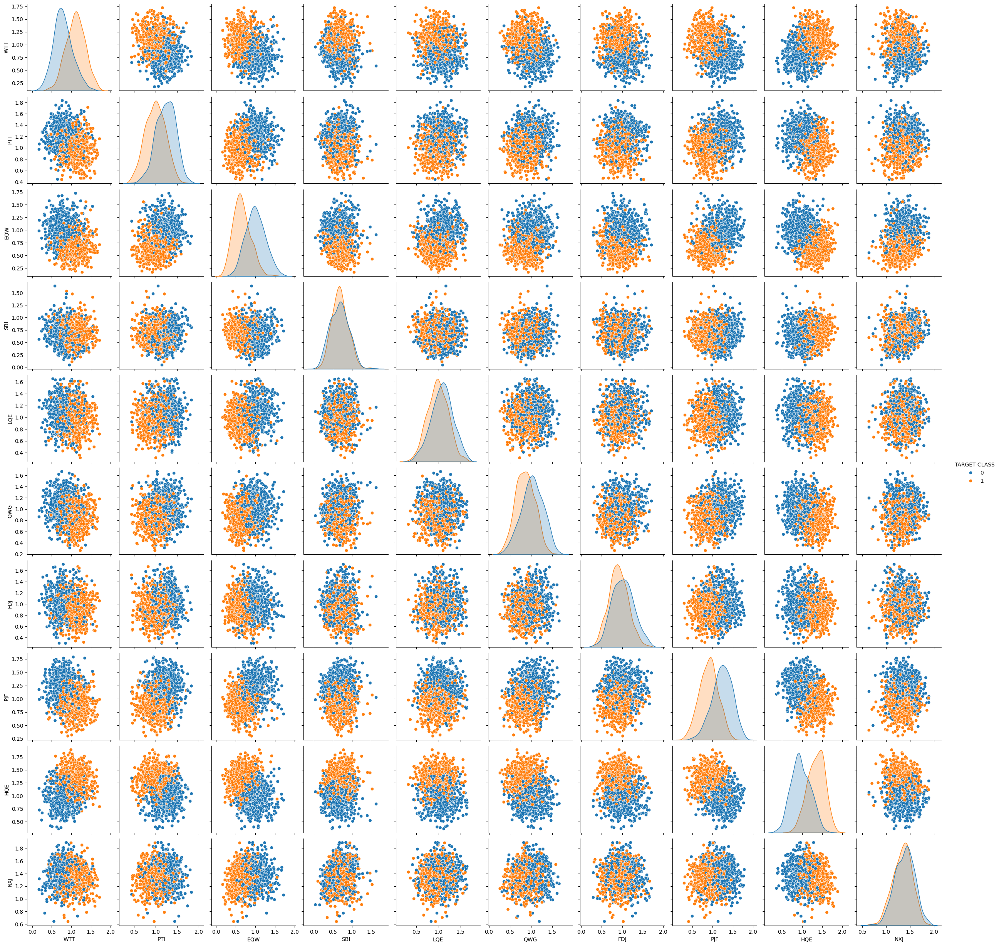

In [11]:
sns.pairplot(df,hue='TARGET CLASS')

from the above graph it is clear that data is not linear and distributed and since the target class is 0 or 1,Classification can be applied.

<Axes: >

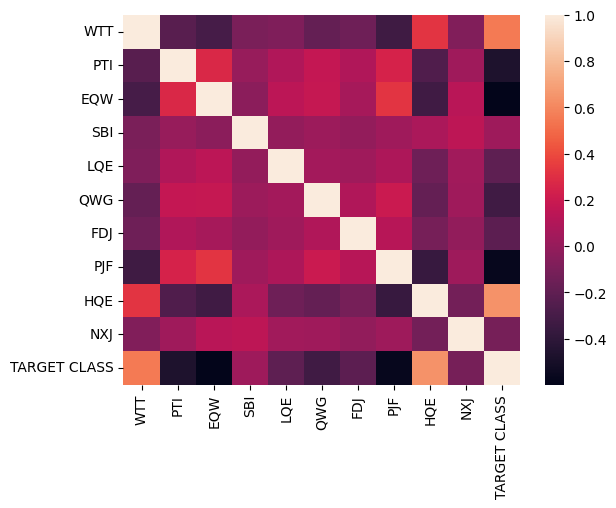

In [12]:
corr=df.corr()
sns.heatmap(corr)

Neither of the values are correlated

Standardize the Variables

In [13]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()

In [14]:
scaler.fit(df.drop('TARGET CLASS',axis=1))

StandardScaler()

In [15]:
scaled_features=scaler.transform(df.drop('TARGET CLASS',axis=1))


In [16]:
X=pd.DataFrame(scaled_features,columns=df.columns[:-1])
X.head()

,WTT,PTI,EQW,SBI,LQE,QWG,FDJ,PJF,HQE,NXJ
0,-0.123542,0.185907,-0.913431,0.319629,-1.033637,-2.308375,-0.798951,-1.482368,-0.949719,-0.643314
1,-1.084836,-0.430348,-1.025313,0.625388,-0.444847,-1.152706,-1.129797,-0.202240,-1.828051,0.636759
2,-0.788702,0.339318,0.301511,0.755873,2.031693,-0.870156,2.599818,0.285707,-0.682494,-0.377850
3,0.982841,1.060193,-0.621399,0.625299,0.452820,-0.267220,1.750208,1.066491,1.241325,-1.026987
4,1.139275,-0.640392,-0.709819,-0.057175,0.822886,-0.936773,0.596782,-1.472352,1.040772,0.276510


In [17]:
y=df['TARGET CLASS']
y

0      1
1      0
2      0
3      1
4      1
      ..
995    1
996    0
997    1
998    1
999    1
Name: TARGET CLASS, Length: 1000, dtype: int64

Checking for Outliers

a.Z-Score Method

In [18]:
from sklearn.neighbors import KNeighborsClassifier,LocalOutlierFactor
from sklearn.ensemble import IsolationForest
from  scipy.stats import zscore

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

In [19]:
z_scores=np.abs(zscore(X))
outliers_z=np.where(z_scores > 3)
#identifying the unique rows that are outliers
outliers_z=np.unique(outliers_z[0])

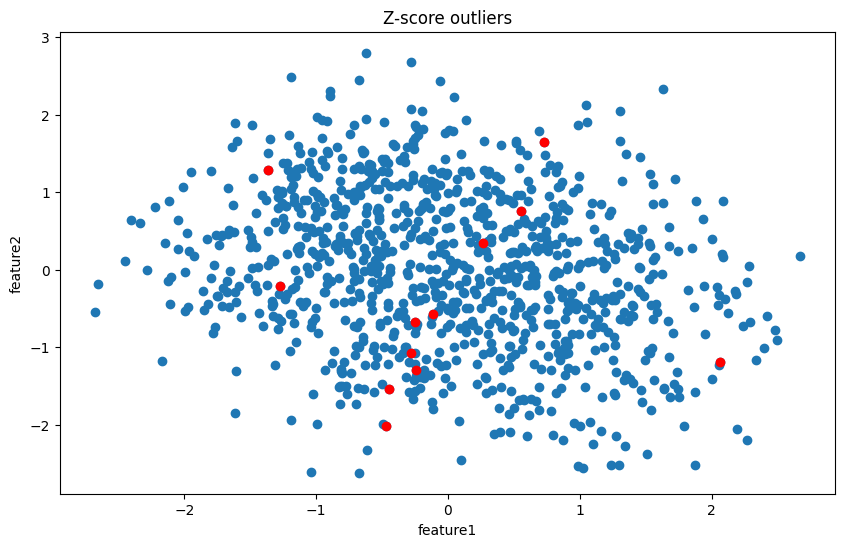

In [20]:
plt.figure(figsize=(10,6))
plt.scatter(X.iloc[:,0],X.iloc[:,1],label='Normal Points')
plt.scatter(X.iloc[outliers_z,0],X.iloc[outliers_z,1],label='Z Score Outliers Points',color='r')
plt.xlabel('feature1')
plt.ylabel('feature2')
plt.title('Z-score outliers')
plt.show()

b.Isolaotion Forest 

In [21]:
iso=IsolationForest(contamination=0.1,random_state=42)
outliers_iso=iso.fit_predict(X)== -1
outliers_iso_idx=np.where(outliers_iso)[0]


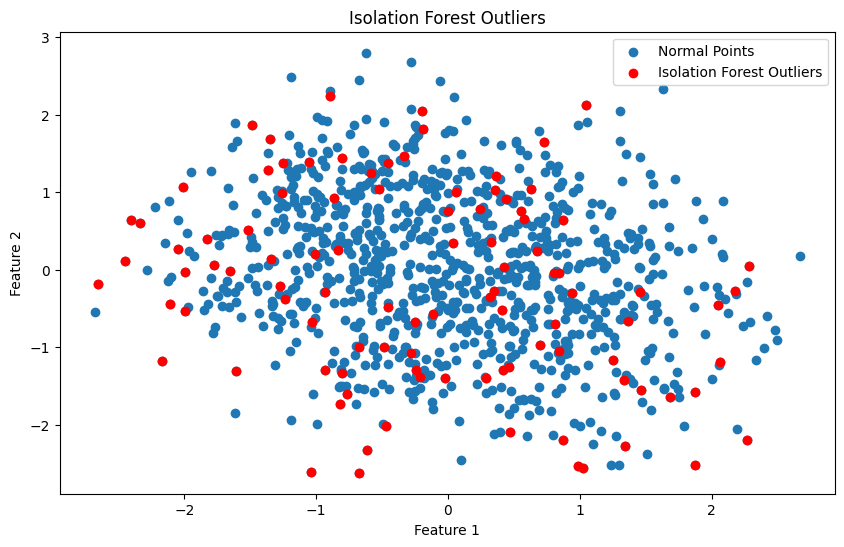

In [22]:
plt.figure(figsize=(10, 6))
plt.scatter(X.iloc[:, 0], X.iloc[:, 1], label='Normal Points')
plt.scatter(X.iloc[outliers_iso_idx, 0], X.iloc[outliers_iso_idx, 1], color='r', label='Isolation Forest Outliers')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.title('Isolation Forest Outliers')
plt.legend()
plt.show()

c.Local Outlier Factor

In [23]:
lof=LocalOutlierFactor(n_neighbors=20,contamination=0.1)
outliers_lof=lof.fit_predict(X)==-1
outliers_lof_idx=np.where(outliers_lof)[0]

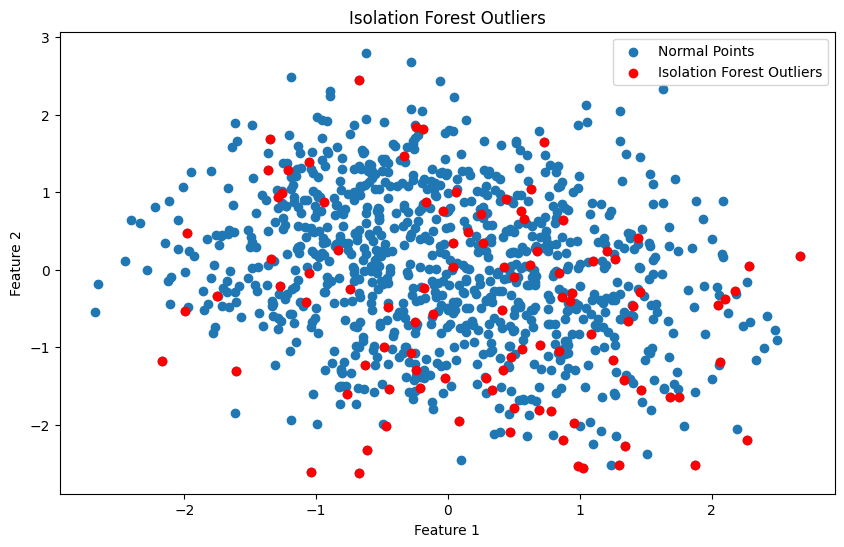

In [24]:
plt.figure(figsize=(10, 6))
plt.scatter(X.iloc[:, 0], X.iloc[:, 1], label='Normal Points')
plt.scatter(X.iloc[outliers_lof_idx, 0], X.iloc[outliers_lof_idx, 1], color='r', label='Isolation Forest Outliers')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.title('Isolation Forest Outliers')
plt.legend()
plt.show()

In [25]:
combined_outliers=np.unique(np.concatenate([outliers_z,outliers_iso_idx,outliers_lof_idx]))
c=np.count_nonzero(combined_outliers)
c


142

There are total 142 outliers in the data

PLotting the same for all the features in the data using Pairplot(Red dots indicates the outliers)

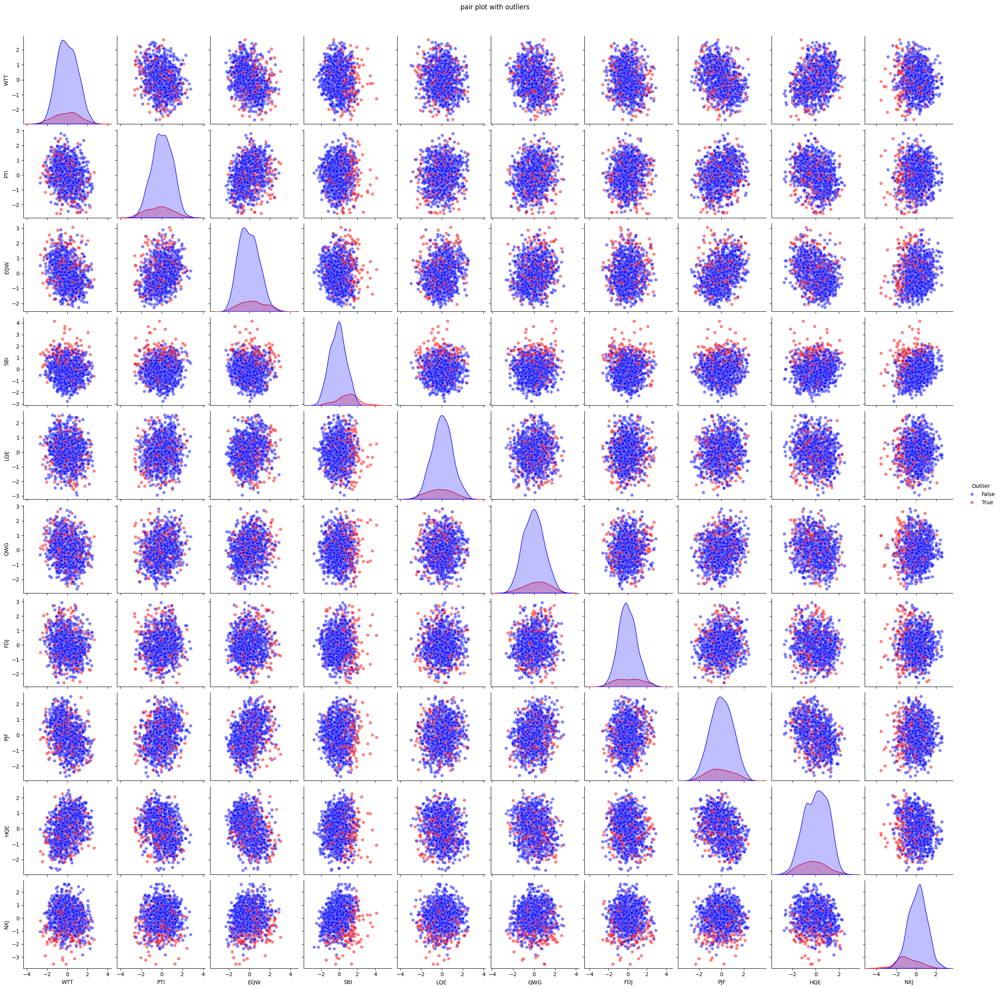

In [24]:
outlier_flags=np.zeros(X.shape[0],dtype=bool)
outlier_flags[combined_outliers]=True

X_with_outliers=X.copy()
X_with_outliers['Outlier']=outlier_flags

#Create pair plot
sns.pairplot(X_with_outliers,hue="Outlier",palette={False:'b',True:'r'},
             plot_kws={'alpha':0.5})
plt.suptitle('pair plot with outliers',y=1.02)
plt.show()

Handling the Outliers

a.Remove the Outliers

In [26]:
X_clean=X.drop(index=combined_outliers)
y_clean=y.drop(index=combined_outliers)

In [27]:
X_clean_flag=X.copy()
X_clean_flag['Outlier']='original'
X_clean_flag.loc[combined_outliers,'Outlier']='removed'

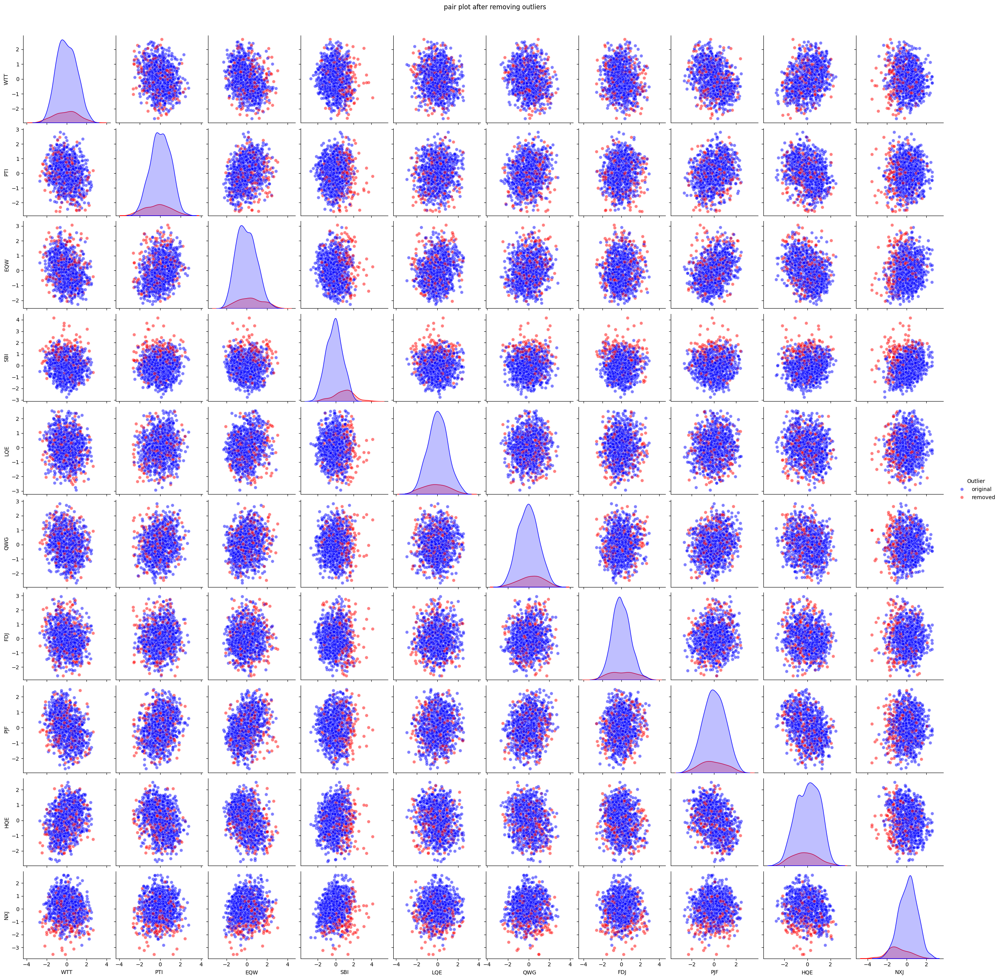

In [28]:

sns.pairplot(X_clean_flag,hue='Outlier',palette={'original':'b','removed':'r'},plot_kws={'alpha':0.5})
plt.suptitle('pair plot after removing outliers',y=1.02)
plt.show()

b.Transform Outliers

In [29]:
X

,WTT,PTI,EQW,SBI,LQE,QWG,FDJ,PJF,HQE,NXJ
0,-0.123542,0.185907,-0.913431,0.319629,-1.033637,-2.308375,-0.798951,-1.482368,-0.949719,-0.643314
1,-1.084836,-0.430348,-1.025313,0.625388,-0.444847,-1.152706,-1.129797,-0.202240,-1.828051,0.636759
2,-0.788702,0.339318,0.301511,0.755873,2.031693,-0.870156,2.599818,0.285707,-0.682494,-0.377850
3,0.982841,1.060193,-0.621399,0.625299,0.452820,-0.267220,1.750208,1.066491,1.241325,-1.026987
4,1.139275,-0.640392,-0.709819,-0.057175,0.822886,-0.936773,0.596782,-1.472352,1.040772,0.276510
...,...,...,...,...,...,...,...,...,...,...
995,0.211653,-0.312490,0.065163,-0.259834,0.017567,-1.395721,-0.849486,-2.604264,-0.139347,-0.069602
996,-1.292453,-0.616901,0.369613,0.482648,1.569891,1.273495,0.362784,-1.242110,-0.679746,1.473448
997,0.641777,-0.513083,-0.179205,1.022255,-0.539703,-0.229680,-2.261339,-2.362494,-0.814261,0.111597
998,0.467072,-0.982786,-1.465194,-0.071465,2.368666,0.001269,-0.422041,-0.036777,0.406025,-0.855670


In [3]:
from scipy.stats import yeojohnson

X_transformed=X.copy()
for column in X.columns:
    X_transformed[column],_=yeojohnson(X[column])

NameError: name 'X' is not defined

In [2]:
X_transformed_with_flag=X_transformed.copy()
X_transformed_with_flag['Outlier']='original'
X_transformed_with_flag.loc[combined_outliers,'Outlier']='removed'

NameError: name 'X_transformed' is not defined

In [1]:
sns.pairplot(X_transformed_with_flag,hue='Outlier',palette={'original':'b','removed':'r'},plot_kws={'alpha':0.5})
plt.suptitle('pair plot after removing outliers',y=1.02)
plt.show()

NameError: name 'sns' is not defined

c. Capping Outliers

In [31]:
def cap_outliers(series,lower_percentile=0.01,upper_percentile=0.99):
    lower_bound=series.quantile(lower_percentile)
    upper_bound=series.quantile(upper_percentile)
    return series.clip(lower_bound,upper_bound)

X_capped=X.apply(cap_outliers)

In [32]:
X_capped_with_flag=X_capped.copy()
X_capped_with_flag['Outlier']='original'
X_capped_with_flag.loc[combined_outliers,'Outlier']='removed'

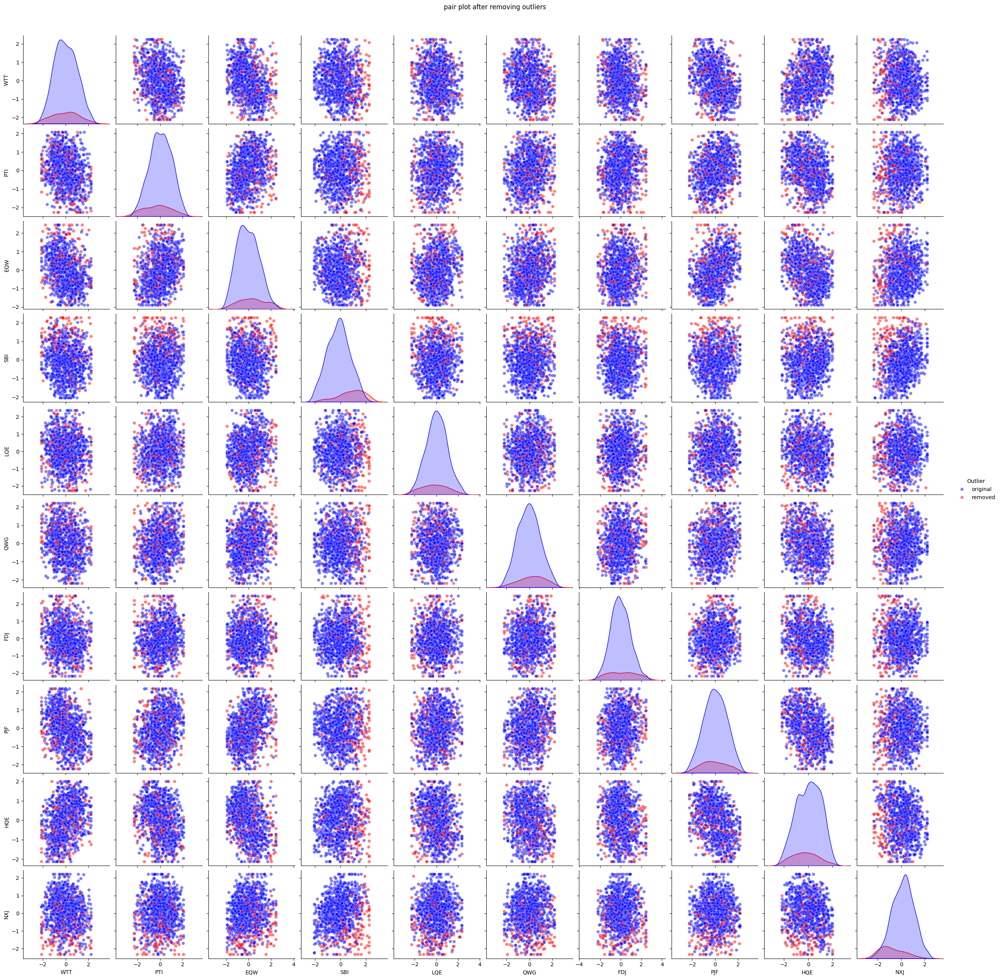

In [33]:
sns.pairplot(X_capped_with_flag,hue='Outlier',palette={'original':'b','removed':'r'},plot_kws={'alpha':0.5})
plt.suptitle('pair plot after removing outliers',y=1.02)
plt.show()

Now choosing either of the corrections ,test the model.

In [35]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test=train_test_split(X_capped,df['TARGET CLASS'],test_size=0.30)
knn=KNeighborsClassifier(n_neighbors=1)
knn.fit(X_train,y_train)

KNeighborsClassifier(n_neighbors=1)

In [36]:
pred=knn.predict(X_test)

Predictions and Evalautaions

In [37]:
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.model_selection import cross_val_score 

In [38]:
print(confusion_matrix(y_test,pred))

[[132  13]
 [ 13 142]]


In [42]:
print(classification_report(y_test,pred))

              precision    recall  f1-score   support

           0       0.91      0.91      0.91       145
           1       0.92      0.92      0.92       155

    accuracy                           0.91       300
   macro avg       0.91      0.91      0.91       300
weighted avg       0.91      0.91      0.91       300



Choosing K Value

In [40]:
accuracy_rate=[]

for i in range(1,40):
    knn=KNeighborsClassifier(n_neighbors=i)
    score=cross_val_score(knn,X_capped,df['TARGET CLASS'],cv=10)
    accuracy_rate.append(score.mean())
    

In [43]:
error_rate = []


for i in range(1,40):
    
    knn = KNeighborsClassifier(n_neighbors=i)
    score=cross_val_score(knn,X_capped,df['TARGET CLASS'],cv=10)
    error_rate.append(1-score.mean())

In [44]:
error_rate = []

# Will take some time
for i in range(1,40):
    
    knn = KNeighborsClassifier(n_neighbors=i)
    knn.fit(X_train,y_train)
    pred_i = knn.predict(X_test)
    error_rate.append(np.mean(pred_i != y_test))

Text(0, 0.5, 'Error Rate')

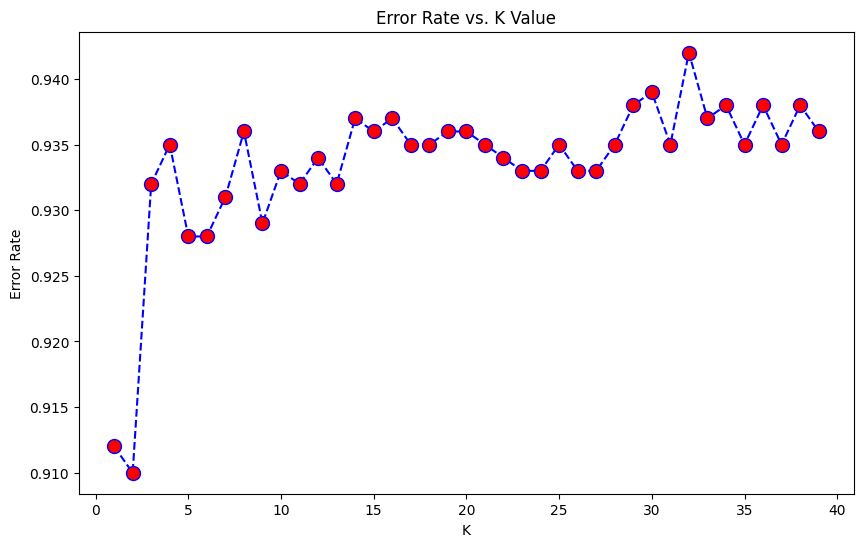

In [45]:
plt.figure(figsize=(10,6))
#plt.plot(range(1,40),error_rate,color='blue', linestyle='dashed', marker='o',
  #       markerfacecolor='red', markersize=10)
plt.plot(range(1,40),accuracy_rate,color='blue', linestyle='dashed', marker='o',
         markerfacecolor='red', markersize=10)
plt.title('Error Rate vs. K Value')
plt.xlabel('K')
plt.ylabel('Error Rate')

It is now viisble that after around K>23 error rate just tends to hover around .Retrianing with the updated value of the K

Original k=1

In [46]:
knn = KNeighborsClassifier(n_neighbors=1)

knn.fit(X_train,y_train)
pred = knn.predict(X_test)

print('WITH K=1')
print('\n')
print(confusion_matrix(y_test,pred))
print('\n')
print(classification_report(y_test,pred))

WITH K=1


[[132  13]
 [ 13 142]]


              precision    recall  f1-score   support

           0       0.91      0.91      0.91       145
           1       0.92      0.92      0.92       155

    accuracy                           0.91       300
   macro avg       0.91      0.91      0.91       300
weighted avg       0.91      0.91      0.91       300



Based on the K value from Elbow graph ,k =23

In [49]:
knn = KNeighborsClassifier(n_neighbors=23)

knn.fit(X_train,y_train)
pred = knn.predict(X_test)

print('WITH K=23')
print('\n')
print(confusion_matrix(y_test,pred))
print('\n')
print(classification_report(y_test,pred))

WITH K=23


[[132  13]
 [  5 150]]


              precision    recall  f1-score   support

           0       0.96      0.91      0.94       145
           1       0.92      0.97      0.94       155

    accuracy                           0.94       300
   macro avg       0.94      0.94      0.94       300
weighted avg       0.94      0.94      0.94       300

